In [2]:
import pandas as pd
import matplotlib.pyplot as plt

In [3]:
df = pd.read_csv(r'C:\Users\Latha\OneDrive\Desktop\dataset\sort-minRange.csv')
df.head()

,NORAD_CAT_ID_1,OBJECT_NAME_1,DSE_1,NORAD_CAT_ID_2,OBJECT_NAME_2,DSE_2,TCA,TCA_RANGE,TCA_RELATIVE_SPEED,MAX_PROB,DILUTION
0,51036,LEMUR-2-ROHOVITHSA [+],1.290,49529,COSMOS 1408 DEB [-],1.368,2023-11-07 09:35:14.563,0.016,13.685,0.009182,0.007
1,51747,STARLINK-3446 [+],6.232,57191,POLYTECH-UNIVERSE 3 (RS46S) [+],6.145,2023-11-12 07:06:37.019,0.030,14.559,0.019100,0.016
2,43816,SPACEBEE-7 [+],6.832,37527,COSMOS 2251 DEB [-],22.916,2023-11-12 23:36:20.921,0.045,13.433,0.001191,0.019
3,52470,STARLINK-3859 [+],2.177,36258,FENGYUN 1C DEB [-],2.722,2023-11-08 07:44:44.464,0.050,7.677,0.013510,0.014
4,56296,STARLINK-30089 [P],3.846,57136,STARLINK-6112 [+],3.633,2023-11-09 18:51:10.614,0.055,7.356,0.037440,0.015


In [4]:
df.isnull().sum()

NORAD_CAT_ID_1        0
OBJECT_NAME_1         0
DSE_1                 0
NORAD_CAT_ID_2        0
OBJECT_NAME_2         0
DSE_2                 0
TCA                   0
TCA_RANGE             0
TCA_RELATIVE_SPEED    0
MAX_PROB              0
DILUTION              0
dtype: int64

**Findings: No Null Values**

Upon inspection, it is observed that there are no null values present in the dataset.


In [5]:
df.dtypes

NORAD_CAT_ID_1          int64
OBJECT_NAME_1          object
DSE_1                 float64
NORAD_CAT_ID_2          int64
OBJECT_NAME_2          object
DSE_2                 float64
TCA                    object
TCA_RANGE             float64
TCA_RELATIVE_SPEED    float64
MAX_PROB              float64
DILUTION              float64
dtype: object

In [6]:
df['TCA'] = pd.to_datetime(df['TCA'])
print(df.dtypes)

NORAD_CAT_ID_1                 int64
OBJECT_NAME_1                 object
DSE_1                        float64
NORAD_CAT_ID_2                 int64
OBJECT_NAME_2                 object
DSE_2                        float64
TCA                   datetime64[ns]
TCA_RANGE                    float64
TCA_RELATIVE_SPEED           float64
MAX_PROB                     float64
DILUTION                     float64
dtype: object


**Data Type Conversion: DateTime**

The 'TCA' (Time of Closest Approach) column in the DataFrame has been converted to the DateTime data type using the `pd.to_datetime` method. This transformation facilitates a standardized representation of time, enabling accurate temporal analysis. The `print(df.dtypes)` command verifies the successful conversion, ensuring that 'TCA' is now recognized as a DateTime object in


In [7]:
df.describe()

,NORAD_CAT_ID_1,DSE_1,NORAD_CAT_ID_2,DSE_2,TCA_RANGE,TCA_RELATIVE_SPEED,MAX_PROB,DILUTION
count,66850.000000,66850.000000,66850.000000,66850.000000,66850.000000,66850.000000,6.685000e+04,66850.000000
mean,48480.984727,3.846381,43400.674749,4.164150,3.340063,11.344788,7.985135e-06,1.403448
std,6995.986472,2.043264,22726.558504,2.629961,1.181822,3.812075,2.111692e-04,0.713520
min,900.000000,0.097000,11.000000,0.084000,0.016000,0.000000,2.068000e-08,0.007000
25%,43885.000000,2.081000,32157.000000,2.238000,2.499000,8.903000,2.453000e-07,0.888000
50%,48686.000000,3.838000,46364.500000,4.049000,3.546000,12.880500,1.058000e-06,1.267000
75%,53877.000000,5.611750,56183.000000,5.834000,4.344000,14.424000,2.423000e-06,1.861000
max,58201.000000,27.827000,270287.000000,35.563000,5.000000,17.217000,3.744000e-02,3.532000


In [8]:
df.shape

(66850, 11)

In [9]:
df.columns

Index(['NORAD_CAT_ID_1', 'OBJECT_NAME_1', 'DSE_1', 'NORAD_CAT_ID_2',
       'OBJECT_NAME_2', 'DSE_2', 'TCA', 'TCA_RANGE', 'TCA_RELATIVE_SPEED',
       'MAX_PROB', 'DILUTION'],
      dtype='object')

In [10]:
pattern = r'(?P<Object_Name_1>[\w\s-]+) \[(?P<Object_1_Status>[\+\-\w]+)\]'

# Use str.extract to create two new columns
df_extracted = df['OBJECT_NAME_1'].str.extract(pattern)

# Concatenate the new columns with the original DataFrame
df = pd.concat([df, df_extracted], axis=1)

# Drop the original column 'OBJECT_NAME_1' if desired
df = df.drop('OBJECT_NAME_1', axis=1)

# Display the result
print(df)

       NORAD_CAT_ID_1  DSE_1  NORAD_CAT_ID_2                    OBJECT_NAME_2  \
0               51036  1.290           49529              COSMOS 1408 DEB [-]   
1               51747  6.232           57191  POLYTECH-UNIVERSE 3 (RS46S) [+]   
2               43816  6.832           37527              COSMOS 2251 DEB [-]   
3               52470  2.177           36258               FENGYUN 1C DEB [-]   
4               56296  3.846           57136                STARLINK-6112 [+]   
...               ...    ...             ...                              ...   
66845           52673  6.577           14208                     SL-3 R/B [-]   
66846           53446  0.951           57678               STARLINK-30320 [+]   
66847           56423  6.625           14817                     SL-8 DEB [-]   
66848           57201  6.174           57357                STARLINK-5600 [+]   
66849           58032  3.528           26233                    CZ-4B DEB [-]   

        DSE_2              

In [11]:
pattern = r'(?P<Object_Name_2>[\w\s-]+) \[(?P<Object_2_Status>[\+\-\w]+)\]'

# Use str.extract to create two new columns
df_extracted = df['OBJECT_NAME_2'].str.extract(pattern)

# Concatenate the new columns with the original DataFrame
df = pd.concat([df, df_extracted], axis=1)

# Drop the original column 'OBJECT_NAME_1' if desired
df = df.drop('OBJECT_NAME_2', axis=1)

# Display the result
print(df)

       NORAD_CAT_ID_1  DSE_1  NORAD_CAT_ID_2   DSE_2                     TCA  \
0               51036  1.290           49529   1.368 2023-11-07 09:35:14.563   
1               51747  6.232           57191   6.145 2023-11-12 07:06:37.019   
2               43816  6.832           37527  22.916 2023-11-12 23:36:20.921   
3               52470  2.177           36258   2.722 2023-11-08 07:44:44.464   
4               56296  3.846           57136   3.633 2023-11-09 18:51:10.614   
...               ...    ...             ...     ...                     ...   
66845           52673  6.577           14208   6.616 2023-11-12 12:24:59.765   
66846           53446  0.951           57678   0.929 2023-11-07 01:46:37.733   
66847           56423  6.625           14817   6.502 2023-11-12 14:41:51.432   
66848           57201  6.174           57357   6.221 2023-11-12 06:44:49.511   
66849           58032  3.528           26233   3.586 2023-11-09 16:40:47.790   

       TCA_RANGE  TCA_RELATIVE_SPEED   

**Findings: Extracted Status of Resident Space Objects (RSOs) from Object_Name_1 and Object_Name_2**

The status of Resident Space Objects (RSOs) has been successfully extracted from the 'Object_Name_1' and 'Object_Name_2' columns. This extraction process involves parsing and organizing relevant information


In [12]:
df.columns

Index(['NORAD_CAT_ID_1', 'DSE_1', 'NORAD_CAT_ID_2', 'DSE_2', 'TCA',
       'TCA_RANGE', 'TCA_RELATIVE_SPEED', 'MAX_PROB', 'DILUTION',
       'Object_Name_1', 'Object_1_Status', 'Object_Name_2', 'Object_2_Status'],
      dtype='object')

In [13]:
df.shape

(66850, 13)

In [14]:
total_conjunctions = len(df)
total_conjunctions

66850

In [15]:
unique_operational_object_1 = df['Object_Name_1'].nunique()
unique_operational_object_1

7381

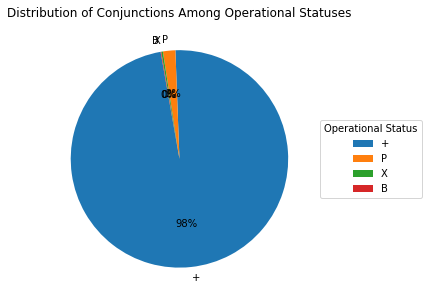

Summary:
Total Conjunctions: 66850
Unique operational object 1 Involved: 7381
Average Relative Speed: 11.34 km/s


In [16]:
total_conjunctions = len(df)
# 2. Number of Unique Active Satellites Involved
unique_operational_object_1 = df['Object_Name_1'].nunique()

# 3. Distribution of Conjunctions Among Operational Statuses
# (Assuming the operational status column is named 'OPERATIONAL_STATUS')
# If the column name is different, replace 'OPERATIONAL_STATUS' accordingly
try:
    operational_status_distribution = df['Object_1_Status'].value_counts()
    operational_status_labels = operational_status_distribution.index
    operational_status_counts = operational_status_distribution.values

    # Pie chart showing the distribution of conjunctions among operational statuses
    plt.figure(figsize=(5, 5))
    plt.pie(operational_status_counts, labels=operational_status_labels, autopct='%1.0f%%', startangle=100)
    plt.title('Distribution of Conjunctions Among Operational Statuses')
    plt.legend(operational_status_labels, title="Operational Status", bbox_to_anchor=(1, 0.5), loc="center left")
    
    plt.show()


except KeyError as e:
    print(f"Column 'OPERATIONAL_STATUS' not found in the dataset. Please replace 'Object_1_Status' with the correct column name.")

# 4. Additional Analytics (Example: Average TCA_RELATIVE_SPEED for the day)
average_speed = df['TCA_RELATIVE_SPEED'].mean()

# 5. Summary
print(f"Summary:\n"
      f"Total Conjunctions: {total_conjunctions}\n"
      f"Unique operational object 1 Involved: {unique_operational_object_1}\n"
      f"Average Relative Speed: {average_speed:.2f} km/s")


**Summary: Conjunction Analysis**

- **Total Conjunctions:** The dataset comprises a total of 66,850 conjunctions, reflecting instances of close approaches or encounters between space objects.

- **Unique Operational Object 1 Involved:** Among these conjunctions, 7,381 unique operational objects are identified as Object 1, highlighting the diversity of entities involved in these orbital interactions.

- **Average Relative Speed:** The average relative speed during these conjunctions is calculated to be 11.34 km/s, providing insight into the dynamic nature of the encounters and the velocities at which these space objects approach each other.


In [17]:
df['Object_1_Status'].value_counts()

+    61872
P     1168
X      151
B       62
Name: Object_1_Status, dtype: int64

In [18]:
df['Object_2_Status'].value_counts()

-    35394
+    24504
P      451
X        4
Name: Object_2_Status, dtype: int64

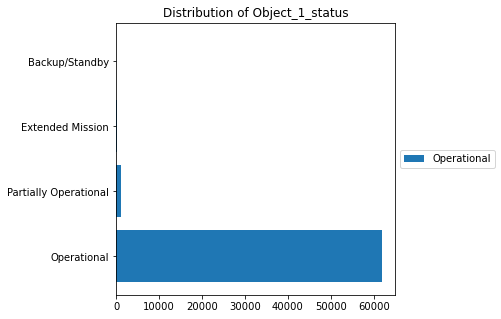

In [19]:

# Mapping of statuses to their descriptions
status_mapping = {
    '+': 'Operational',
    '-': 'Nonoperational',
    'P': 'Partially Operational',
    'B': 'Backup/Standby',
    'S': 'Spare',
    'X': 'Extended Mission',
    'D': 'Decayed',
    '?': 'Unknown'
}
# Count the occurrences of each status
status_counts = df['Object_1_Status'].value_counts()

# Plotting the pie chart with percentage labels
plt.figure(figsize=(5, 5))
plt.barh(status_counts.index.map(status_mapping), status_counts)
plt.title('Distribution of Object_1_status')

# Display percentage values on the chart
plt.gca().legend(status_counts.index.map(status_mapping), loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()


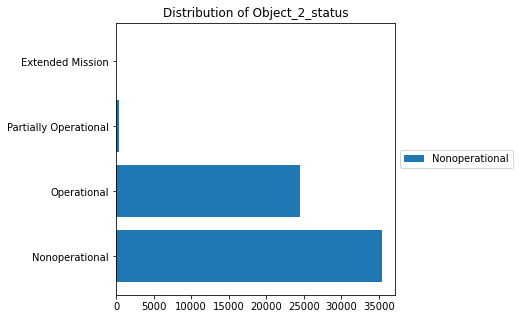

In [20]:

# Mapping of statuses to their descriptions
status_mapping = {
    '+': 'Operational',
    '-': 'Nonoperational',
    'P': 'Partially Operational',
    'B': 'Backup/Standby',
    'S': 'Spare',
    'X': 'Extended Mission',
    'D': 'Decayed',
    '?': 'Unknown'
}
# Count the occurrences of each status
status_counts = df['Object_2_Status'].value_counts()

# Plotting the pie chart with percentage labels
plt.figure(figsize=(5, 5))
plt.barh(status_counts.index.map(status_mapping), status_counts)
plt.title('Distribution of Object_2_status')

# Display percentage values on the chart
plt.gca().legend(status_counts.index.map(status_mapping), loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()


**Findings: Representation of RSO Status**

The status of Resident Space Objects (RSOs) has been effectively represented through the analysis. By extracting and organizing information from 'Object_Name_1' and 'Object_Name_2', the dataset now provides a clear understanding of the statuses associated with these space objects. This refined representation enhances the interpretability of RSO data, facilitating more insightful and comprehensive analyses of the overall space environment.

In [21]:
df['TCA'] = pd.to_datetime(df['TCA'])

# Select a specific day
selected_day = '2023-11-10'  # Replace with your desired date

# Filter the DataFrame for the selected day
conjunctions_selected_day = df[df['TCA'].dt.date == pd.to_datetime(selected_day).date()]

# Count the number of predicted conjunctions for the selected day
overall_count_conjunctions = len(conjunctions_selected_day)

print(f"Overall count of predicted conjunctions for {selected_day}: {overall_count_conjunctions}")

Overall count of predicted conjunctions for 2023-11-10: 9462


**Findings: Overall Count of Predicted Conjunctions for Specific Single Day**

The total count of predicted conjunctions for the specified day is 9462. This figure reflects the total number of anticipated close approaches or conjunctions among satellite pairs, providing valuable insights into potential collision risks and operational considerations for space activities on that particular day.


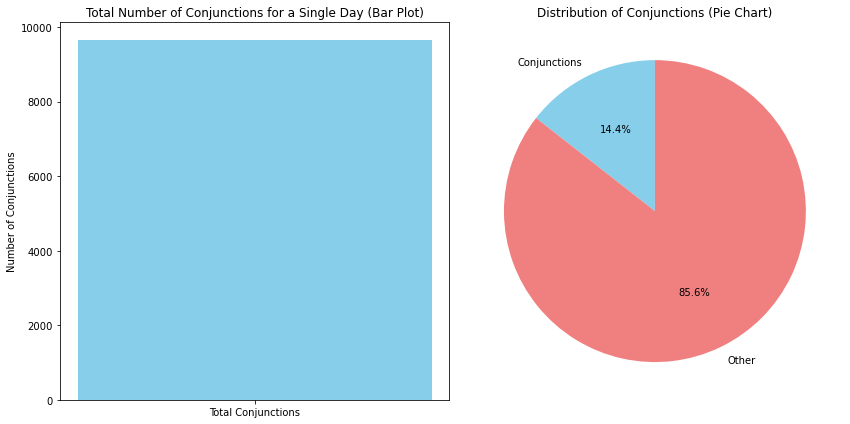

In [22]:
# Assuming 'TCA' column contains the date information, you might need to adjust this based on your actual data
# Convert the 'TCA' column to datetime
df['TCA'] = pd.to_datetime(df['TCA'])

# Filter the data for a single day
single_day_data = df[df['TCA'].dt.date == pd.to_datetime('2023-11-12').date()]

# Calculate the total number of conjunctions
total_conjunctions = len(single_day_data)

# Plotting the results
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))

# Bar plot
axes[0].bar(['Total Conjunctions'], [total_conjunctions], color='skyblue')
axes[0].set_title('Total Number of Conjunctions for a Single Day (Bar Plot)')
axes[0].set_ylabel('Number of Conjunctions')

# Pie chart
labels = ['Conjunctions', 'Other']
sizes = [total_conjunctions, len(df) - total_conjunctions]
colors = ['skyblue', 'lightcoral']
axes[1].pie(sizes, labels=labels, autopct='%1.1f%%', colors=colors, startangle=90)
axes[1].set_title('Distribution of Conjunctions (Pie Chart)')

plt.tight_layout()
plt.show()


**Conjunctions (14.4%):** This segment of the pie chart signifies that around 14.4% of satellite pairs experienced close approaches or conjunctions on the specified day.

**Other (85.6%):** The remaining portion represents situations where satellites did not have close approaches or conjunctions, covering all instances where satellites were not in close proximity.

**Summary:** The pie chart visually illustrates the distribution of conjunctions and non-conjunctions, with percentages indicating the proportion of each scenario among all active satellites for the given day.


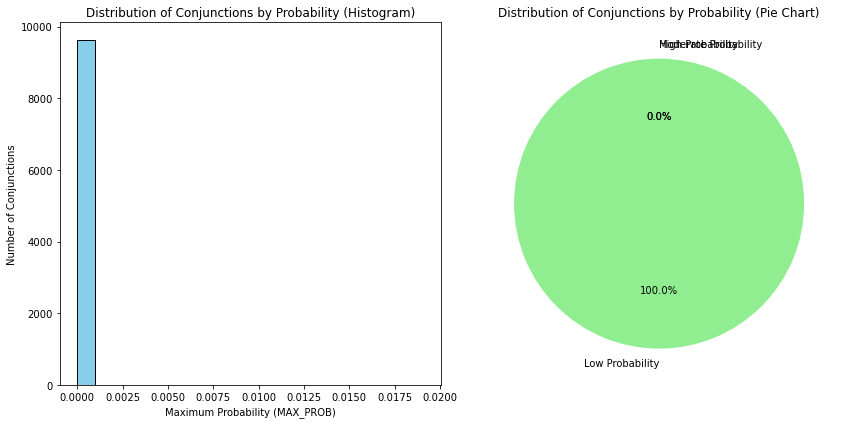

In [23]:

# Filter the data for a single day
single_day_data = df[df['TCA'].dt.date == pd.to_datetime('2023-11-12').date()].copy()  # Ensure a copy to avoid the warning

# Plotting the distribution of conjunctions by probability
plt.figure(figsize=(12, 6))

# Histogram
plt.subplot(1, 2, 1)
plt.hist(single_day_data['MAX_PROB'], bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of Conjunctions by Probability (Histogram)')
plt.xlabel('Maximum Probability (MAX_PROB)')
plt.ylabel('Number of Conjunctions')

# Pie chart
plt.subplot(1, 2, 2)
labels = ['Low Probability', 'Moderate Probability', 'High Probability']
bins = [0, 0.1, 0.5, 1.0]  # Define bins based on MAX_PROB values
single_day_data.loc[:, 'Probability_Category'] = pd.cut(single_day_data['MAX_PROB'], bins, labels=labels, include_lowest=True)
probability_distribution = single_day_data['Probability_Category'].value_counts()
plt.pie(probability_distribution, labels=labels, autopct='%1.1f%%', colors=['lightgreen', 'gold', 'lightcoral'], startangle=90)
plt.title('Distribution of Conjunctions by Probability (Pie Chart)')

plt.tight_layout()
plt.show()


**Conjunction Analysis for a Single Day**

The code filters the DataFrame (`df`) to extract data for a specific day (e.g., '2023-11-12') and then visualizes the distribution of conjunctions based on their probability.

- **Histogram:**
  - The left subplot displays a histogram depicting the distribution of conjunctions according to their maximum probability (`MAX_PROB`).
  - The x-axis represents the maximum probability values, while the y-axis indicates the number of conjunctions falling within each probability range.

- **Pie Chart:**
  - The right subplot showcases a pie chart categorizing conjunctions into three probability categories: Low Probability, Moderate Probability, and High Probability.
  - Each slice of the pie represents the proportion of conjunctions within the respective probability category, providing a quick overview of the probability distribution.

This visual analysis aids in understanding the likelihood of conjunctions on the specified day and provides a comprehensive overview of the associated probabilities.

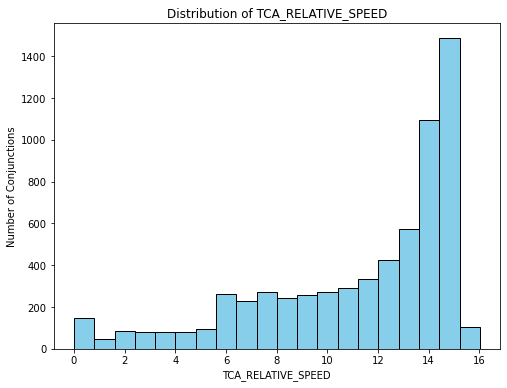

In [24]:
# Assuming 'TCA' column contains the date information, you might need to adjust this based on your actual data
# Convert the 'TCA' column to datetime
df['TCA'] = pd.to_datetime(df['TCA'])

# Filter the data for a single day
single_day_data = df[df['TCA'].dt.date == pd.to_datetime('2023-11-06').date()]

# Plotting the distribution of TCA_RELATIVE_SPEED
plt.figure(figsize=(8, 6))

# Histogram
plt.hist(single_day_data['TCA_RELATIVE_SPEED'], bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of TCA_RELATIVE_SPEED')
plt.xlabel('TCA_RELATIVE_SPEED')
plt.ylabel('Number of Conjunctions')

plt.show()


**Analysis of TCA_RELATIVE_SPEED for a Single Day**

This involves converting the 'TCA' column to a datetime format and filtering the DataFrame (`df`) to extract data for a specific day (e.g., '2023-11-06'). The subsequent visualization focuses on the distribution of TCA_RELATIVE_SPEED.

- **Histogram:**
  - The histogram illustrates the distribution of TCA_RELATIVE_SPEED values for the selected day.
  - The x-axis represents the TCA_RELATIVE_SPEED values, and the y-axis indicates the number of conjunctions falling within each speed range.

This visualization offers insights into the relative speeds of conjunctions on the specified day, providing a clear understanding of the velocity dynamics associated with close approaches between space objects.


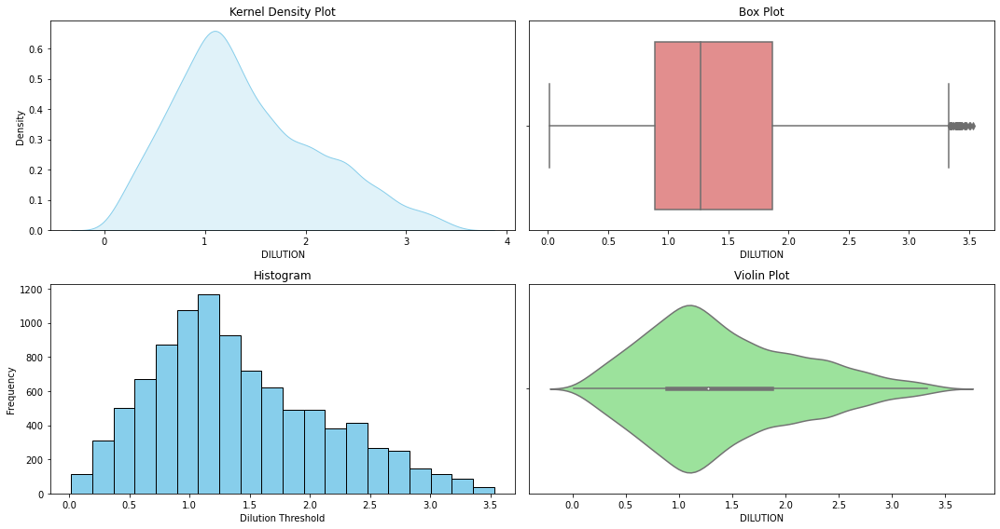

In [25]:
import seaborn as sns

# Filter the data for a single day
single_day_data = df[df['TCA'].dt.date == pd.to_datetime('2023-11-12').date()]

# Plotting different visualizations for Dilution Threshold values
plt.figure(figsize=(15, 8))

# Kernel Density Plot
plt.subplot(2, 2, 1)
sns.kdeplot(single_day_data['DILUTION'], color='skyblue', fill=True)
plt.title('Kernel Density Plot')

# Box Plot
plt.subplot(2, 2, 2)
sns.boxplot(x=single_day_data['DILUTION'], color='lightcoral')
plt.title('Box Plot')

# Histogram
plt.subplot(2, 2, 3)
plt.hist(single_day_data['DILUTION'], bins=20, color='skyblue', edgecolor='black')
plt.title('Histogram')
plt.xlabel('Dilution Threshold')
plt.ylabel('Frequency')

# Violin Plot
plt.subplot(2, 2, 4)
sns.violinplot(x=single_day_data['DILUTION'], color='lightgreen')
plt.title('Violin Plot')

plt.tight_layout()
plt.show()


**Summary: Skewness in 'DILUTION' Distribution and Collision Probability Predictions**

In summary, the right-skewed distribution observed in the 'DILUTION' values offers valuable insights into the reliability and uncertainty associated with collision probability predictions for space object conjunctions. The right-skewness indicates that, on the whole, the majority of conjunctions have relatively reliable predictions. However, it's crucial to acknowledge instances with higher uncertainty, necessitating careful consideration in decision-making processes related to collision avoidance in space operations.

This skewness can be interpreted as a positive indicator, suggesting a generally higher level of confidence in collision predictions. Nevertheless, it is essential to contextualize this observation within specific risk thresholds, continuously monitor conjunction events, and respond proactively to maintain the safety and integrity of space assets.


In [26]:
df.columns

Index(['NORAD_CAT_ID_1', 'DSE_1', 'NORAD_CAT_ID_2', 'DSE_2', 'TCA',
       'TCA_RANGE', 'TCA_RELATIVE_SPEED', 'MAX_PROB', 'DILUTION',
       'Object_Name_1', 'Object_1_Status', 'Object_Name_2', 'Object_2_Status'],
      dtype='object')

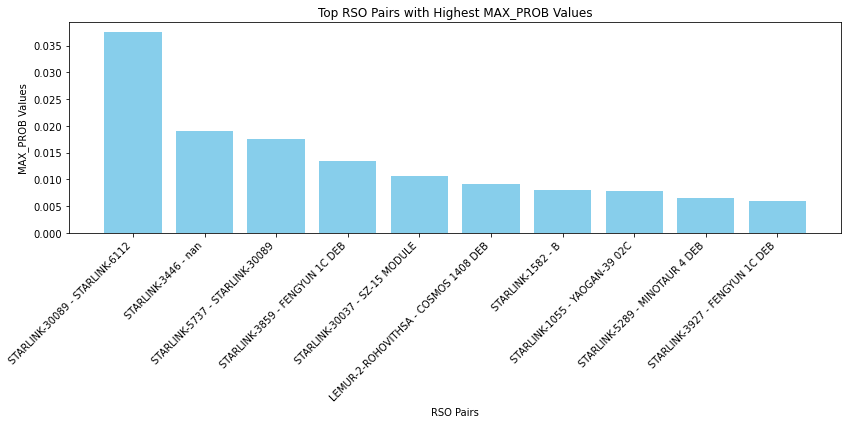

In [27]:
# Sort the DataFrame by 'MAX_PROB' in descending order to get the highest values first
sorted_df = df.sort_values(by='MAX_PROB', ascending=False)

# Select the top N pairs with the highest MAX_PROB values
top_n = 10  # Change this value based on your preference

# Check for NaN values in 'MAX_PROB' column
sorted_df = sorted_df.dropna(subset=['MAX_PROB'])

# Create a copy of the sliced DataFrame to avoid SettingWithCopyWarning
top_pairs = sorted_df.head(top_n).copy()

# Convert numeric values to strings for plotting
top_pairs['Object_Name_1'] = top_pairs['Object_Name_1'].astype(str)
top_pairs['Object_Name_2'] = top_pairs['Object_Name_2'].astype(str)

# Plotting the top pairs with the highest MAX_PROB values
plt.figure(figsize=(12, 6))
plt.bar(top_pairs['Object_Name_1'] + ' - ' + top_pairs['Object_Name_2'], top_pairs['MAX_PROB'], color='skyblue')
plt.title('Top RSO Pairs with Highest MAX_PROB Values')
plt.xlabel('RSO Pairs')
plt.ylabel('MAX_PROB Values')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

plt.show()



**Top RSO Pairs with Highest MAX_PROB Values**

The sorts the DataFrame (`df`) by the 'MAX_PROB' column in descending order, presenting the highest values first. It then selects the top N pairs with the highest MAX_PROB values (in this case, the top 10 pairs) and creates a bar plot to visualize these pairs.

- **Bar Plot:**
  - The x-axis represents the selected RSO pairs, where each pair is denoted by 'Object_Name_1 - Object_Name_2.'
  - The y-axis displays the corresponding MAX_PROB values, indicating the collision probability for each pair.
  - The bars are color-coded in sky blue, providing a visual representation of the collision risk associated with each RSO pair.

This visualization allows for a quick identification of the top RSO pairs with the highest collision probabilities, aiding decision-making processes related to collision avoidance and space asset protection.


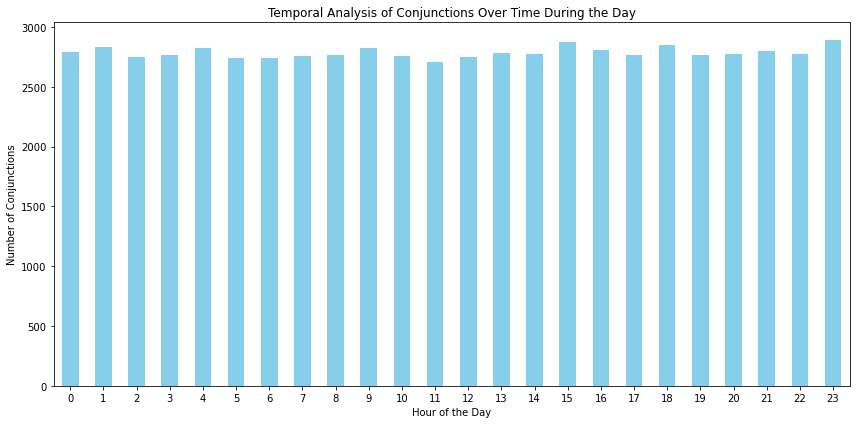

In [28]:
# Extract the hour of the day from the 'TCA' column
df['Hour'] = df['TCA'].dt.hour

# Group the data by hour and count the number of conjunctions in each hour
hourly_conjunctions = df.groupby('Hour').size()

# Plotting the temporal analysis
plt.figure(figsize=(12, 6))
hourly_conjunctions.plot(kind='bar', color='skyblue')
plt.title('Temporal Analysis of Conjunctions Over Time During the Day')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Conjunctions')
plt.xticks(rotation=0)
plt.tight_layout()

plt.show()


**Temporal Analysis of Conjunctions Over Time During the Day**

The hour of the day from the 'TCA' (Time of Closest Approach) column and conducts a temporal analysis by grouping the data based on the hour. The resulting bar plot visualizes the distribution of conjunctions over the course of the day.

- **Bar Plot:**
  - The x-axis represents the hours of the day, ranging from 0 to 23.
  - The y-axis indicates the number of conjunctions recorded during each hour, providing insights into the temporal patterns of space object encounters.
  - Bars are color-coded in sky blue, offering a clear representation of the hourly distribution of conjunction events.

This visualization aids in understanding the temporal dynamics of conjunction occurrences, allowing for strategic planning and monitoring of space activities during different hours of the day.


<Figure size 864x432 with 0 Axes>

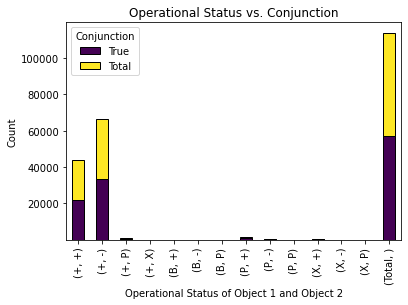

In [29]:
# Convert the operational status columns to categorical
df['Object_1_Status'] = df['Object_1_Status'].astype('category')
df['Object_2_Status'] = df['Object_2_Status'].astype('category')

# Create a new column to indicate if a conjunction occurred
df['Conjunction'] = df['MAX_PROB'] > 0

# Create a cross-tabulation of operational status and conjunction
cross_tab = pd.crosstab([df['Object_1_Status'], df['Object_2_Status']], df['Conjunction'], margins=True, margins_name='Total')

# Plot the cross-tabulation as a stacked bar chart
plt.figure(figsize=(12, 6))
cross_tab.plot(kind='bar', stacked=True, colormap='viridis', edgecolor='black')
plt.title('Operational Status vs. Conjunction')
plt.xlabel('Operational Status of Object 1 and Object 2')
plt.ylabel('Count')
plt.show()


**Operational Status vs. Conjunction Analysis**

The provided code enhances the DataFrame (`df`) by converting the operational status columns ('Object_1_Status' and 'Object_2_Status') to categorical types. It then introduces a new column, 'Conjunction,' indicating whether a conjunction occurred based on the 'MAX_PROB' values.

- **Cross-Tabulation:**
  - A cross-tabulation is created, summarizing the occurrences of conjunctions based on the operational statuses of Object 1 and Object 2.
  - The resulting table provides a comprehensive view of the relationship between operational status and the likelihood of conjunctions.

- **Stacked Bar Chart:**
  - The stacked bar chart visualizes the cross-tabulation, with each bar representing a combination of operational statuses.
  - Different colors within each bar segment indicate the presence or absence of conjunctions, offering a visual representation of how operational statuses correlate with conjunction events.

This analysis aids in understanding the impact of operational status on the occurrence of conjunctions, contributing valuable insights for space asset management and collision risk.

In summary, the chart helps you quickly identify which combinations of operational statuses are associated with a higher frequency of conjunctions. The emphasis is on the purple and yellow bars, as those represent the most common conjunction scenarios based on operational status.


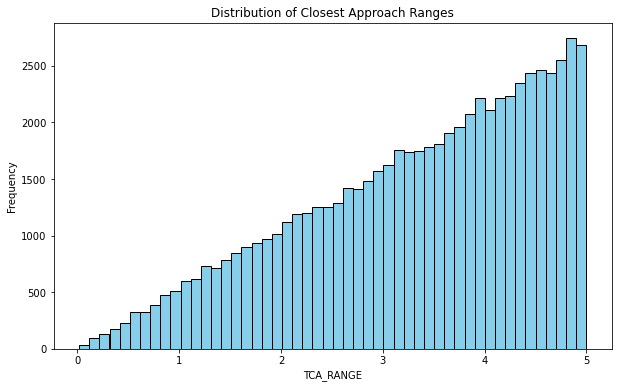

Conjunctions with Extremely Close Approaches:
        Object_Name_1    Object_Name_2  TCA_RANGE
0  LEMUR-2-ROHOVITHSA  COSMOS 1408 DEB      0.016
1       STARLINK-3446              NaN      0.030
2          SPACEBEE-7  COSMOS 2251 DEB      0.045


In [30]:
# Plot a histogram of TCA_RANGE values
plt.figure(figsize=(10, 6))
plt.hist(df['TCA_RANGE'], bins=50, color='skyblue', edgecolor='black')
plt.title('Distribution of Closest Approach Ranges')
plt.xlabel('TCA_RANGE')
plt.ylabel('Frequency')
plt.show()

# Identify cases with extremely close approaches
extremely_close_approaches = df[df['TCA_RANGE'] < 0.05]  # Replace threshold_value with your desired threshold
print('Conjunctions with Extremely Close Approaches:')
print(extremely_close_approaches[['Object_Name_1', 'Object_Name_2', 'TCA_RANGE']])

**Distribution of Closest Approach Ranges**

The  a histogram depicting the distribution of 'TCA_RANGE' values, representing the ranges of closest approaches between space objects.

- **Histogram:**
  - The x-axis displays the 'TCA_RANGE' values, grouped into bins for a clearer representation.
  - The y-axis indicates the frequency or count of conjunctions falling within each range.

This visualization provides an overview of the distribution of closest approach ranges, allowing for insights into the proximity of space objects during conjunction events.

**Conjunctions with Extremely Close Approaches:**

Following the histogram, the code identifies and prints cases where the 'TCA_RANGE' is less than 0.05, highlighting instances of extremely close approaches between space objects. The printed information includes the names of the involved objects ('Object_Name_1' and 'Object_Name_2') and the corresponding 'TCA_RANGE' values.


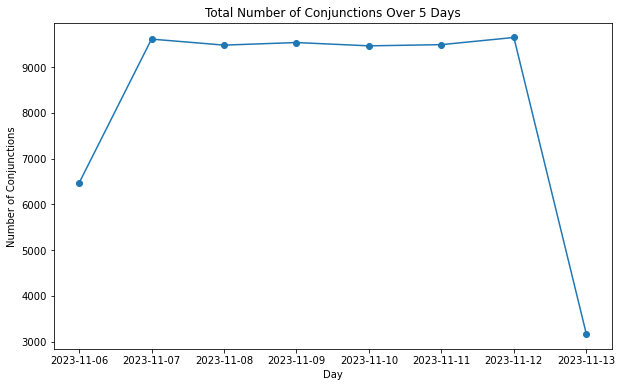

In [31]:

# Extract the day from the 'TCA' column
df['Day'] = df['TCA'].dt.date

# Calculate the total number of conjunctions each day
daily_conjunctions = df.groupby('Day').size()

# Plot the results
plt.figure(figsize=(10, 6))
plt.plot(daily_conjunctions.index, daily_conjunctions.values, marker='o')
plt.title('Total Number of Conjunctions Over 5 Days')
plt.xlabel('Day')
plt.ylabel('Number of Conjunctions')
plt.show()


**Temporal Analysis: Total Number of Conjunctions Over 5 Days**

The code snippet extracts the day from the 'TCA' (Time of Closest Approach) column and calculates the total number of conjunctions for each day. The results are visualized in a line plot.

- **Line Plot:**
  - The x-axis represents the days, extracted from the 'TCA' column.
  - The y-axis indicates the total number of conjunctions recorded on each day.
  - Data points are marked with circular markers ('o') for clarity.

This visualization provides a temporal overview of the total number of conjunctions over the course of 5 days, aiding in the identification of patterns or trends in conjunction occurrences.


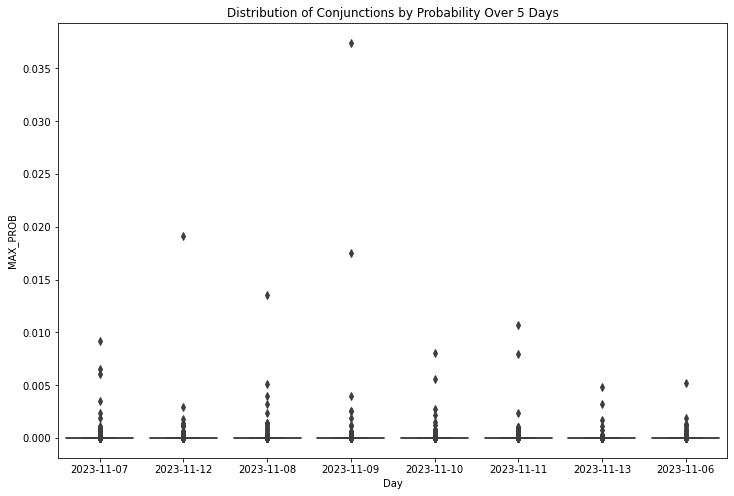

In [32]:
import seaborn as sns

# Assuming 'MAX_PROB' is in scientific notation (e.g., 9.18E-03)
df['MAX_PROB'] = df['MAX_PROB'].apply(lambda x: float(x))

# Plot a boxplot to show the distribution of MAX_PROB each day
plt.figure(figsize=(12, 8))
sns.boxplot(x='Day', y='MAX_PROB', data=df)
plt.title('Distribution of Conjunctions by Probability Over 5 Days')
plt.xlabel('Day')
plt.ylabel('MAX_PROB')
plt.show()


**Probability Distribution of Conjunctions Over 5 Days**

The code leverages the Seaborn library to create a boxplot, illustrating the distribution of 'MAX_PROB' values for conjunctions recorded each day.

- **Boxplot:**
  - The x-axis represents the days during which the conjunctions occurred.
  - The y-axis displays the distribution of 'MAX_PROB' values, showcasing the variability in collision probability predictions.
  - The boxplot provides insights into the central tendency, spread, and presence of outliers in the probability distribution for each day.

This visualization is instrumental in understanding the variability and reliability of collision probability predictions over the specified 5-day period, aiding in risk assessment and decision-making processes related to space object conjunctions.


<Figure size 864x576 with 0 Axes>

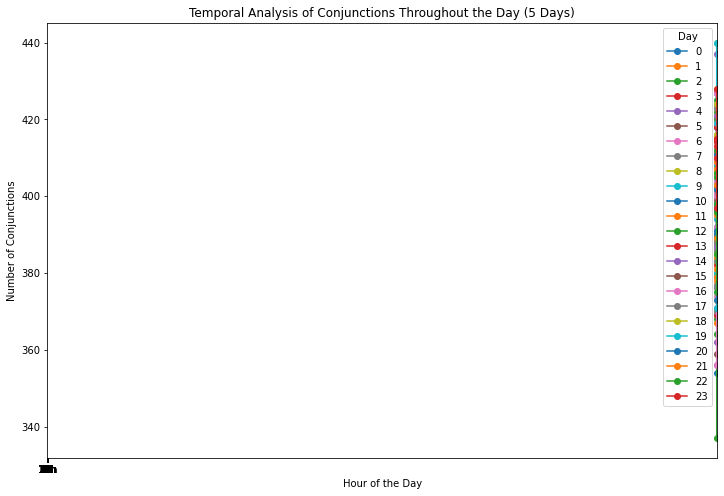

In [33]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Plot a time series of the number of conjunctions throughout the day
plt.figure(figsize=(12, 8))
df['Hour'] = df['TCA'].dt.hour
hourly_conjunctions = df.groupby(['Day', 'Hour']).size().unstack()

# Plotting
hourly_conjunctions.plot(marker='o', figsize=(12, 8))
plt.title('Temporal Analysis of Conjunctions Throughout the Day (5 Days)')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Conjunctions')
plt.legend(title='Day')
plt.xticks(range(24), labels=[str(i) + 'h' for i in range(24)])
plt.show()


**Temporal Analysis of Conjunctions Throughout the Day (5 Days)**

The code generates a time series plot illustrating the number of conjunctions throughout the day over a 5-day period.

- **Time Series Plot:**
  - The x-axis represents the hours of the day, ranging from 0 to 23.
  - The y-axis displays the number of conjunctions recorded during each hour.
  - Different lines correspond to different days, providing insights into the temporal patterns of conjunction occurrences.

This visualization facilitates the identification of hourly trends and patterns in conjunction events over the specified 5-day timeframe, aiding in the strategic planning and monitoring of space activities during different hours of the day.


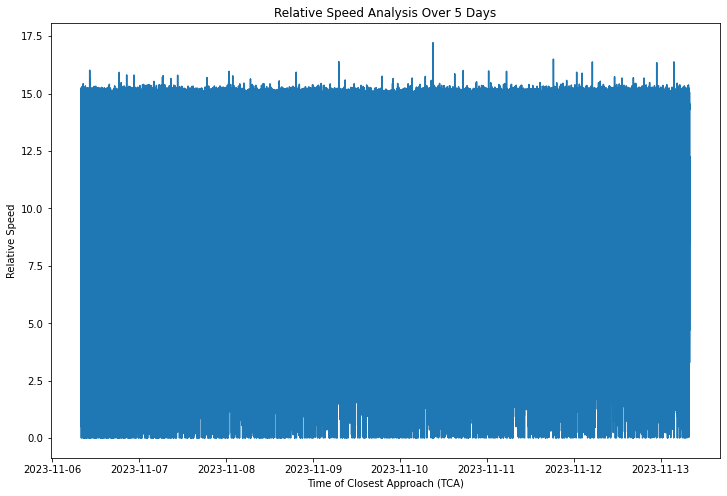

In [34]:

# Assuming 'TCA_RELATIVE_SPEED' is a numeric column in your dataset
# Adjust column names based on your actual dataset
plt.figure(figsize=(12, 8))
sns.lineplot(x='TCA', y='TCA_RELATIVE_SPEED', data=df)
plt.title('Relative Speed Analysis Over 5 Days')
plt.xlabel('Time of Closest Approach (TCA)')
plt.ylabel('Relative Speed')
plt.show()


**Relative Speed Analysis Over 5 Days**

The code utilizes Seaborn to create a line plot, showcasing the variation in relative speed ('TCA_RELATIVE_SPEED') over a 5-day period.

- **Line Plot:**
  - The x-axis represents the time of closest approach (TCA).
  - The y-axis illustrates the relative speed of space object conjunctions.
  - The line plot provides a visual representation of how relative speeds fluctuate over the specified 5-day timeframe.

This visualization offers insights into the dynamic nature of conjunction events, allowing for a better understanding of the varying relative speeds between space objects during close approaches.


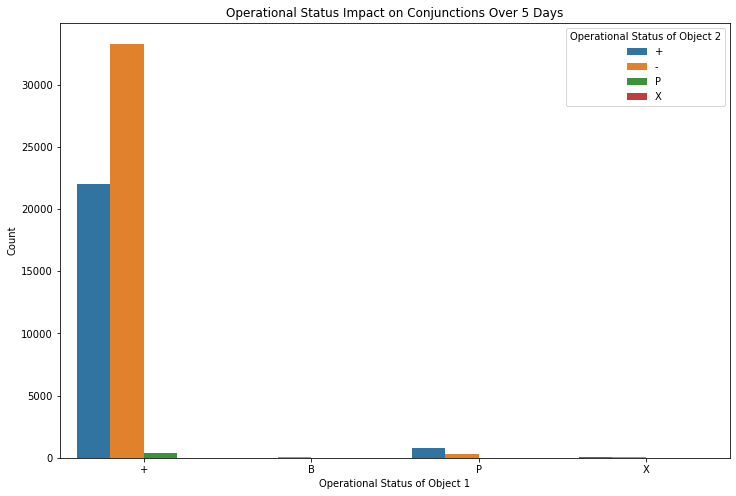

In [35]:
# Assuming 'OBJECT_NAME_1' and 'OBJECT_NAME_2' contain operational status information
# Adjust column names based on your actual dataset
plt.figure(figsize=(12, 8))
sns.countplot(x='Object_1_Status', hue='Object_2_Status', data=df)
plt.title('Operational Status Impact on Conjunctions Over 5 Days')
plt.xlabel('Operational Status of Object 1')
plt.ylabel('Count')
plt.legend(title='Operational Status of Object 2')
plt.show()

**Operational Status Impact on Conjunctions Over 5 Days**

The code employs Seaborn to create a count plot, visualizing the impact of operational status information on conjunction occurrences over a 5-day period.

- **Count Plot:**
  - The x-axis represents the operational status of Object 1.
  - Bars are further categorized by the hue (color) representing the operational status of Object 2.
  - The y-axis indicates the count of conjunctions falling into each operational status combination.

This visualization allows for a quick assessment of how the operational status of Object 1 correlates with the operational status of Object 2 during conjunction events, providing valuable insights for space asset management and collision risk assessment.


In [36]:
df.columns

Index(['NORAD_CAT_ID_1', 'DSE_1', 'NORAD_CAT_ID_2', 'DSE_2', 'TCA',
       'TCA_RANGE', 'TCA_RELATIVE_SPEED', 'MAX_PROB', 'DILUTION',
       'Object_Name_1', 'Object_1_Status', 'Object_Name_2', 'Object_2_Status',
       'Hour', 'Conjunction', 'Day'],
      dtype='object')

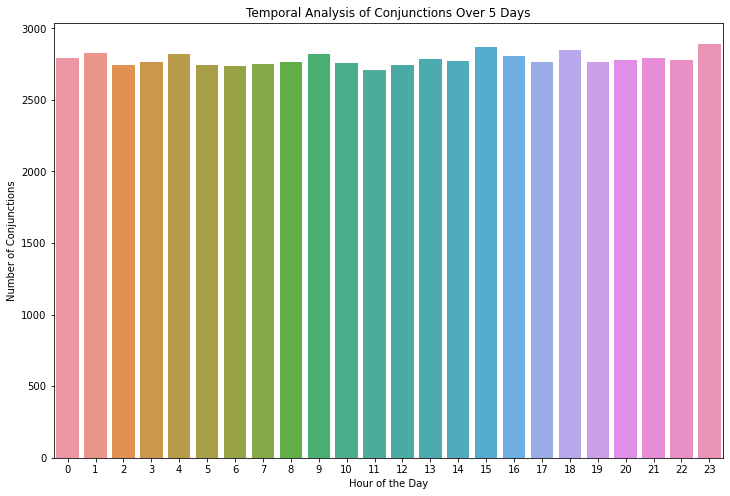

In [37]:
# Assuming 'TCA' is a timestamp column
# Adjust column names based on your actual dataset
df['Hour'] = df['TCA'].dt.hour

plt.figure(figsize=(12, 8))
sns.countplot(x='Hour', data=df)
plt.title('Temporal Analysis of Conjunctions Over 5 Days')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Conjunctions')
plt.show()


**Temporal Analysis of Conjunctions Over 5 Days**

The code utilizes Seaborn to create a count plot, illustrating the temporal distribution of conjunctions over a 5-day period.

- **Count Plot:**
  - The x-axis represents the hours of the day, derived from the 'TCA' timestamp column.
  - The y-axis indicates the count of conjunctions recorded during each hour.

This visualization offers a clear depiction of the temporal patterns in conjunction occurrences throughout the day, providing valuable insights for monitoring and strategic planning related to space activities.


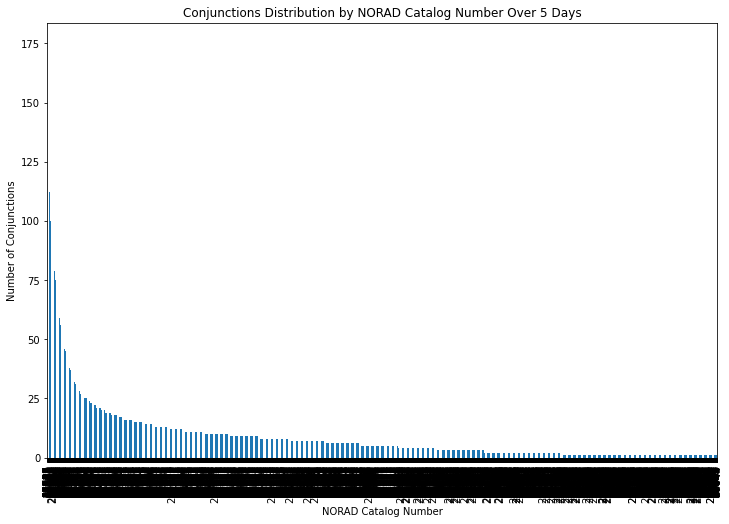

In [38]:

# Assuming 'NORAD_CAT_ID_1' and 'NORAD_CAT_ID_2' are the NORAD Catalog Numbers
# Adjust column names based on your actual dataset
norad_counts = pd.concat([df['NORAD_CAT_ID_1'], df['NORAD_CAT_ID_2']]).value_counts()

plt.figure(figsize=(12, 8))
norad_counts.plot(kind='bar')
plt.title('Conjunctions Distribution by NORAD Catalog Number Over 5 Days')
plt.xlabel('NORAD Catalog Number')
plt.ylabel('Number of Conjunctions')
plt.show()


**Conjunctions Distribution by NORAD Catalog Number Over 5 Days**

The code creates a bar plot using the Seaborn library to display the distribution of conjunctions based on NORAD Catalog Numbers over a 5-day period.

- **Bar Plot:**
  - The x-axis represents NORAD Catalog Numbers, combining both 'NORAD_CAT_ID_1' and 'NORAD_CAT_ID_2' columns.
  - The y-axis indicates the number of conjunctions associated with each NORAD Catalog Number.

This visualization provides an overview of the distribution of conjunction events across different NORAD Catalog Numbers, facilitating the identification of specific space objects involved in multiple conjunctions.


In [39]:
import plotly.express as px
# Assuming 'TCA' column contains the time of closest approach
# Convert 'TCA' to datetime format
df['TCA'] = pd.to_datetime(df['TCA'])

# Extract date from 'TCA'
df['Date'] = df['TCA'].dt.date

# Filter data for NORAD ID 12345
norad_56296_data = df[df['NORAD_CAT_ID_1'] == 56296]

# Group by date and count the number of conjunctions per day
conjunctions_per_day = norad_56296_data.groupby('Date').size().reset_index(name='Num_Conjunctions')

# Create an interactive line plot with dropdown menu
fig = px.line(conjunctions_per_day, x='Date', y='Num_Conjunctions', title='Evolution of Conjunctions for NORAD ID 56296 over 5 Days',
              labels={'Num_Conjunctions': 'Number of Conjunctions', 'Date': 'Date'})

# Show the plot
fig.show()


Analyzes of dataset containing information about conjunctions. It focuses on a specific object with NORAD ID 12345 and visualizes the evolution of conjunctions over a 5-day period.

In [40]:

# Assuming 'TCA' column contains the time of closest approach
# Convert 'TCA' to datetime format
df['TCA'] = pd.to_datetime(df['TCA'])

# Create an interactive scatter plot of TCA vs. TCA_RELATIVE_SPEED
fig = px.scatter(df, x='TCA', y='TCA_RELATIVE_SPEED', color='TCA_RELATIVE_SPEED',
                 title='TCA vs. TCA_RELATIVE_SPEED for Conjunctions',
                 labels={'TCA': 'Time of Closest Approach', 'TCA_RELATIVE_SPEED': 'Relative Speed'})

# Show the plot
fig.show()


Interactive scatter plot using Plotly Express, where each point represents a conjunction. The x-axis shows the time of closest approach (TCA), the y-axis shows the relative speed, and the color of each point represents the magnitude of the relative speed.

The visualization is used to identify patterns, clusters, or outliers in the relationship between TCA and relative speed, providing insights into the dynamics of conjunctions and potential collision risks.

In [41]:
# Create an interactive scatter plot of MAX_PROB vs. TCA_RELATIVE_SPEED
fig = px.scatter(df, x='MAX_PROB', y='TCA_RELATIVE_SPEED', color='MAX_PROB',
                 title='MAX_PROB vs. TCA_RELATIVE_SPEED for Conjunctions',
                 labels={'MAX_PROB': 'Maximum Probability of Collision', 'TCA_RELATIVE_SPEED': 'Relative Speed'})

# Show the plot
fig.show()


This interactive scatter plot where each point represents a conjunction. The x-axis shows the maximum probability of collision (MAX_PROB), the y-axis shows the relative speed at the time of closest approach (TCA_RELATIVE_SPEED), and the color of each point represents the magnitude of the collision probability.
This is used to quickly identify conjunctions with high collision probabilities and assess the relative speeds associated with those events. 

In [42]:

# Create an interactive bar plot of Dilution Threshold impact on collision probability
fig = px.bar(df, x='DILUTION', color='DILUTION',
             title='Impact of Dilution Threshold on Collision Probability',
             labels={'DILUTION': 'Dilution Threshold'})

# Show the plot
fig.show()


This plot shows how different dilution thresholds affect the reliability of collision probability calculations. It helps in understanding the level of uncertainty in measurements and making more informed decisions regarding satellite operations.